In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from pathlib import Path
import pandas as pd
from tqdm import tqdm
import json
import numpy as np
import pickle

import matplotlib.pyplot as plt
import seaborn as sns
from openslide import OpenSlide

In [3]:
plt.rcParams.update({'font.size': 25})

patch_size = 1024

In [4]:
slide_list = {path.name: OpenSlide(str(path)).get_thumbnail(size=(patch_size, patch_size)) for path in tqdm(Path(r"D:\Datasets\ScannerStudy").glob("*/*/*.*")) 
                      if path.suffix in [".svs", ".ndpi", ".tif"]}

slide_list

76it [01:13,  1.04it/s]


{'A_CCMCT_183715A_1.svs': <PIL.Image.Image image mode=RGB size=1024x880 at 0x209CF7DBB38>,
 'A_CCMCT_22108_1.svs': <PIL.Image.Image image mode=RGB size=1024x881 at 0x209CF7DB5C0>,
 'A_CCMCT_29609B_1.svs': <PIL.Image.Image image mode=RGB size=848x1024 at 0x209CF7DB668>,
 'A_CCMCT_380609B_1.svs': <PIL.Image.Image image mode=RGB size=1024x726 at 0x209CF7DBCC0>,
 'A_CCMCT_518711B_1.svs': <PIL.Image.Image image mode=RGB size=1024x795 at 0x209CF7DBD30>,
 'A_BB_563476_1.svs': <PIL.Image.Image image mode=RGB size=1024x1023 at 0x209CF7DBDA0>,
 'A_BB_563479_1.svs': <PIL.Image.Image image mode=RGB size=992x1024 at 0x209CF7E8080>,
 'A_BB_568320_1.svs': <PIL.Image.Image image mode=RGB size=1024x1003 at 0x209CF7E80B8>,
 'A_BB_568381_1.svs': <PIL.Image.Image image mode=RGB size=1024x931 at 0x209CF7E80F0>,
 'A_BB_574162_1.svs': <PIL.Image.Image image mode=RGB size=1003x1024 at 0x209CF7E8240>,
 'Z_CCMCT_183715A_1.tif': <PIL.Image.Image image mode=RGB size=1024x872 at 0x209CF7E8198>,
 'Z_CCMCT_22108_1.t

In [5]:
coordinates = {
    "L0": (0, 0), 
    "L1": (1, 0), 
    "L2": (2, 0), 
    "L3": (3, 0),   
    "L4": (4, 0),
    
    "L5": (0, 1),
    "L6": (1, 1),
    "L7": (2, 1),
    "L8": (3, 1),    
    "L9": (4, 1),
    
    "L10": (0, 2),
    "L11": (1, 2),
    "L12": (2, 2),
    "L13": (3, 2),    
    "L14": (4, 2),
    
    "L15": (0, 3),
    "L16": (1, 3),
    "L17": (2, 3),
    "L18": (3, 3),    
    "L19": (4, 3),
    
    "L20": (0, 4),
    "L21": (1, 4),
    "L22": (2, 4),
    "L23": (3, 4),    
    "L24": (4, 4),
}

In [6]:
def add_help_fields(frame):
    
    frame["image_name_stem"] = [Path(image_name).stem for image_name in frame["image_name"]]
    
    frame["patient_id"] = [name.split("_")[2] for name in frame["image_name"]]

    frame["x1"] = [json.loads(vector.replace("\'","\""))['x1'] for vector in frame["vector"]]
    frame["y1"] = [json.loads(vector.replace("\'","\""))['y1'] for vector in frame["vector"]]

    frame["x2"] = [json.loads(vector.replace("\'","\""))['x2'] for vector in frame["vector"]]
    frame["y2"] = [json.loads(vector.replace("\'","\""))['y2'] for vector in frame["vector"]]

    frame["center_x"] = [x1 + ((x2-x1) / 2) for x1, x2 in zip(frame["x1"], frame["x2"])]
    frame["center_y"] = [y1 + ((y2-y1) / 2) for y1, y2 in zip(frame["y1"], frame["y2"])]
    
    frame["center"] = [np.array((center_x, center_y)) for center_x, center_y in zip(frame["center_x"], frame["center_y"])]

    frame["anno_width"] = [x2-x1 for x1, x2 in zip(frame["x1"], frame["x2"])]
    frame["anno_height"]= [y2-y1 for y1, y2 in zip(frame["y1"], frame["y2"])]
    
    return frame

In [25]:
gt_annotations = add_help_fields(pd.read_csv("GT.csv"))

predicted_annotations = add_help_fields(pd.concat([pd.read_csv("QuadTree.csv"), pd.read_csv("GT_Registration_Home.csv")]))
predicted_annotations.head()

,scanner,image_id,image_name,image_type,image_width,image_height,vector,unique_identifier,annotation_type,type_name,...,patient_id,x1,y1,x2,y2,center_x,center_y,center,anno_width,anno_height
0,S210,10408,N1_CCMCT_183715A_1.ndpi,CCMCT,96000,84480,"{'x1': 20999, 'x2': 21055, 'y1': 16716, 'y2': ...",45e2d88d-8211-419b-a754-6d71dd317ec5,384,L0,...,183715A,20999,16716,21055,16772,21027.0,16744.0,"[21027.0, 16744.0]",56,56
1,S210,10408,N1_CCMCT_183715A_1.ndpi,CCMCT,96000,84480,"{'x1': 15083, 'x2': 15139, 'y1': 28973, 'y2': ...",ff307a78-11ec-4a05-b8c8-ad90a2cb18ed,385,L1,...,183715A,15083,28973,15139,29029,15111.0,29001.0,"[15111.0, 29001.0]",56,56
2,S210,10408,N1_CCMCT_183715A_1.ndpi,CCMCT,96000,84480,"{'x1': 13726, 'x2': 13782, 'y1': 43558, 'y2': ...",ee578e27-99c4-4ab9-a10a-0a19fd58f4fa,386,L2,...,183715A,13726,43558,13782,43614,13754.0,43586.0,"[13754.0, 43586.0]",56,56
3,S210,10408,N1_CCMCT_183715A_1.ndpi,CCMCT,96000,84480,"{'x1': 13858, 'x2': 13914, 'y1': 56811, 'y2': ...",27f6e3b9-8627-414a-b6d8-b8e111031d54,387,L3,...,183715A,13858,56811,13914,56867,13886.0,56839.0,"[13886.0, 56839.0]",56,56
4,S210,10408,N1_CCMCT_183715A_1.ndpi,CCMCT,96000,84480,"{'x1': 30962, 'x2': 31018, 'y1': 15404, 'y2': ...",212779a8-3d64-4ea3-a604-a7f775bb4d0f,389,L5,...,183715A,30962,15404,31018,15460,30990.0,15432.0,"[30990.0, 15432.0]",56,56


In [26]:
predicted_annotations.shape

(2635, 22)

In [27]:
predicted_annotations["method"].unique()

array(['QTree_L0', 'QTree_L1', 'QTree_L2', 'GT_Registration'],
      dtype=object)

In [28]:
results = []

for image_name in predicted_annotations["image_name"].unique():
    
    gt_annotations_image = gt_annotations[gt_annotations["image_name"] == image_name]
    predicted_annotations_image = predicted_annotations[predicted_annotations["image_name"] == image_name]
    
    for method in predicted_annotations_image["method"].unique():
        
        method_annos = predicted_annotations_image[predicted_annotations_image["method"] == method]
        
        intersections = list(set(gt_annotations_image["type_name"]).intersection(method_annos["type_name"]))
        
        for type_name in intersections:

            gt_anno = gt_annotations_image[gt_annotations_image["type_name"] == type_name].iloc[0]     
            predicted_anno = method_annos[method_annos["type_name"] == type_name].iloc[0]

            distance = np.linalg.norm(gt_anno.center-predicted_anno.center)

            x_start = gt_anno.center_x / gt_anno.image_width * slide_list[image_name].width
            x_end = predicted_anno.center_x / predicted_anno.image_width * slide_list[image_name].width
            y_start = gt_anno.center_y / gt_anno.image_height * slide_list[image_name].height
            y_end = predicted_anno.center_y / predicted_anno.image_height * slide_list[image_name].height


            grid_x, grid_y = coordinates[gt_anno.type_name]

            row = [gt_anno.scanner, image_name, gt_anno.image_type, gt_anno.annotation_type, 
                   gt_anno.type_name, gt_anno.patient_id, distance, grid_x, grid_y,
                  x_start, x_end, y_start, y_end, method]
            results.append(row)

results = pd.DataFrame(results, columns=["scanner", "image_name", "image_type", "annotation_type", 
                                         "type_name", "patient_id", "distance", "grid_x", "grid_y",
                                        "x_start", "x_end", "y_start", "y_end", "method"])
results.head()

,scanner,image_name,image_type,annotation_type,type_name,patient_id,distance,grid_x,grid_y,x_start,x_end,y_start,y_end,method
0,S210,N1_CCMCT_183715A_1.ndpi,CCMCT,409,L22,183715A,52.801515,2,4,836.384000,835.872000,476.576527,476.341892,QTree_L0
1,S210,N1_CCMCT_183715A_1.ndpi,CCMCT,387,L3,183715A,47.169906,3,0,148.384000,148.117333,606.628539,606.201929,QTree_L0
2,S210,N1_CCMCT_183715A_1.ndpi,CCMCT,406,L19,183715A,57.801384,4,3,688.896000,688.405333,756.464583,756.091300,QTree_L0
3,S210,N1_CCMCT_183715A_1.ndpi,CCMCT,398,L11,183715A,41.785165,1,2,509.429333,509.013333,313.558239,313.398260,QTree_L0
4,S210,N1_CCMCT_183715A_1.ndpi,CCMCT,396,L9,183715A,56.639209,4,1,334.912000,334.506667,763.951586,763.503646,QTree_L0


In [29]:
method_comparision = []

for image_type in results["image_type"].unique():
    for method in results["method"].unique():
        for type_name in results["type_name"].unique():
            for scanner in results["scanner"].unique():
            
                df = results[(results["image_type"] == image_type) & 
                             (results["method"] == method) & 
                             (results["type_name"] == type_name) & 
                             (results["scanner"] == scanner)]

                if df.empty == False:
                    sum_dist = df["distance"].median()

                    grid_x, grid_y = df.iloc[0].grid_x, df.iloc[0].grid_y

                    method_comparision.append([method, scanner, image_type, type_name, sum_dist, grid_x, grid_y])
method_comparision = pd.DataFrame(method_comparision, columns=["method", "scanner", "image_type", "type_name", 
                                                               "sum_dist", "grid_x", "grid_y"])
method_comparision.head()

,method,scanner,image_type,type_name,sum_dist,grid_x,grid_y
0,QTree_L0,S210,CCMCT,L22,36.878178,2,4
1,QTree_L0,2.0HT,CCMCT,L22,34.365681,2,4
2,QTree_L0,Axio,CCMCT,L22,37.589892,2,4
3,QTree_L0,S210,CCMCT,L3,43.908997,3,0
4,QTree_L0,2.0HT,CCMCT,L3,64.327288,3,0


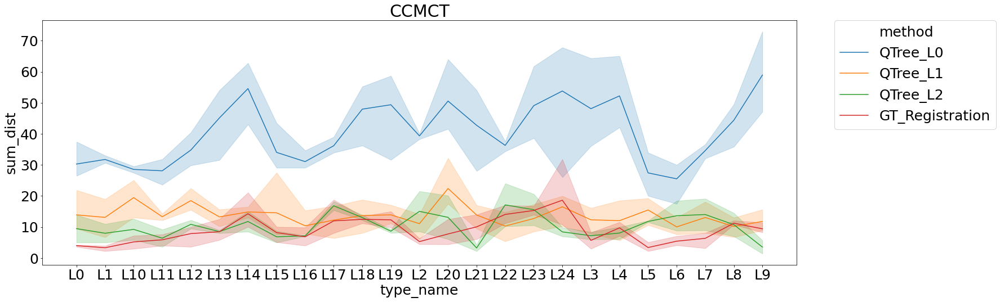

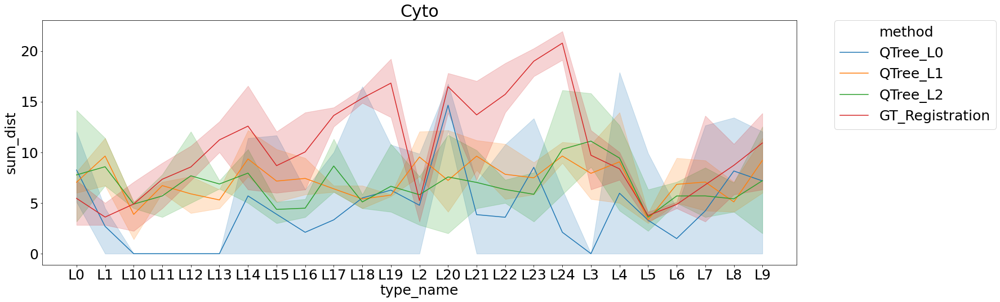

In [30]:
for image_type in method_comparision["image_type"].unique():
    
    image_type_data = method_comparision[method_comparision["image_type"] == image_type]
    
    fig, ax = plt.subplots(figsize=(24, 8))

    ax.set_title(f"{image_type_data.iloc[0].image_type}")
    sns.lineplot(x="type_name", y="sum_dist",
                 hue="method",  #scanner
                 #style="method",
                 data=image_type_data, ax=ax)

    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.show()


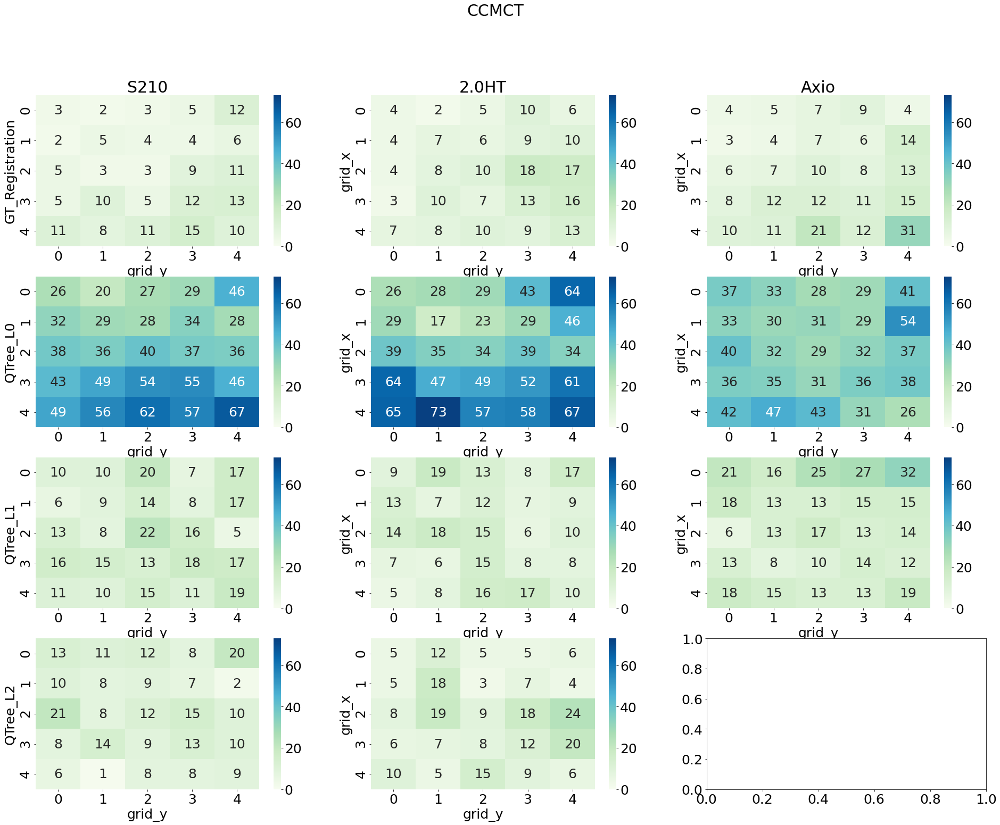

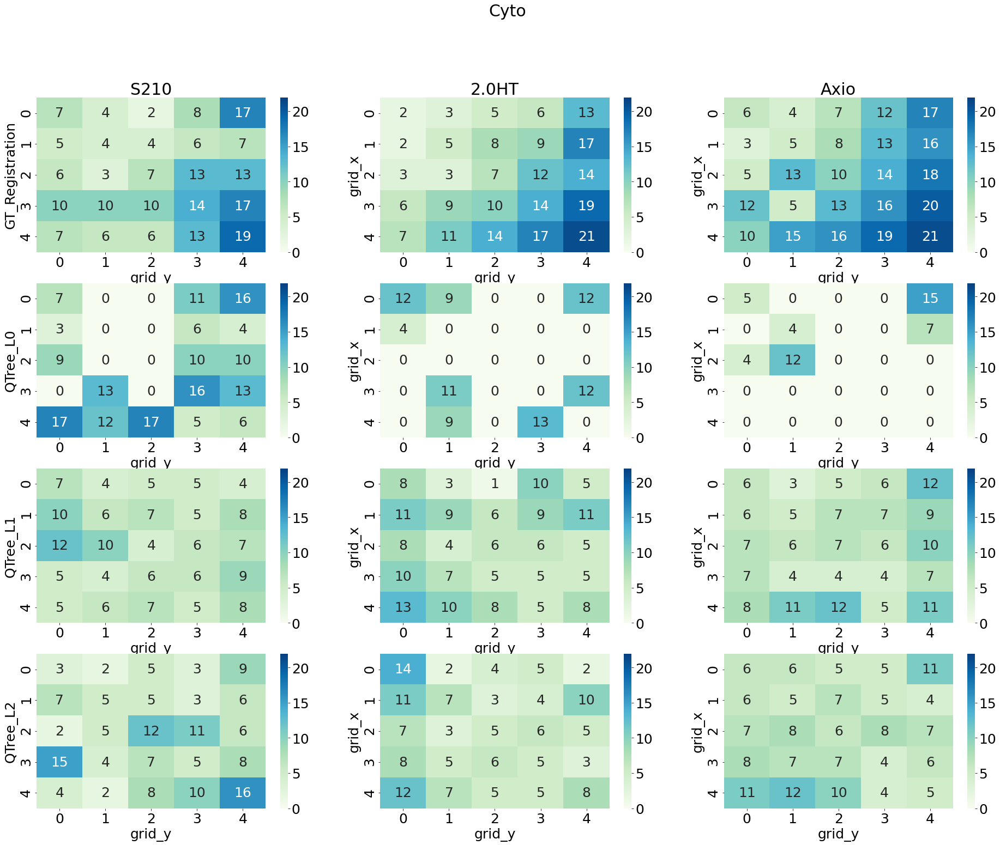

In [31]:
for image_type in method_comparision["image_type"].unique():
    
    image_type_data = method_comparision[method_comparision["image_type"] == image_type]
    
    max_distance = max(image_type_data["sum_dist"])
    
    fig, ((ax_1, ax_2, ax_3), (ax_4, ax_5, ax_6), 
          (ax_7, ax_8, ax_9), (ax_10, ax_11, ax_12))  = plt.subplots(4, 3, figsize=(32, 24))
    
    fig.suptitle(f"{image_type}")
    
    for scanner, ax, method in [
                        ("S210", ax_1, "GT_Registration"), ("2.0HT", ax_2, "GT_Registration"), ("Axio", ax_3, "GT_Registration"),
                        ("S210", ax_4, "QTree_L0"), ("2.0HT", ax_5, "QTree_L0"), ("Axio", ax_6, "QTree_L0"),
                        ("S210", ax_7, "QTree_L1"), ("2.0HT", ax_8, "QTree_L1"), ("Axio", ax_9, "QTree_L1"),
                        ("S210", ax_10, "QTree_L2"), ("2.0HT", ax_11, "QTree_L2"), ("Axio", ax_12, "QTree_L2"),
                       ]:
        
        
        data = image_type_data[(image_type_data["scanner"] == scanner) & (image_type_data["method"] == method)]
        
        if data.empty == False:
            if method == "GT_Registration":
                ax.set_title(f"{data.iloc[0].scanner}")

            sns.heatmap(data.pivot("grid_x", "grid_y", "sum_dist").replace(np.nan, 0).astype(int), 
                    ax=ax, annot=True, cmap="GnBu", fmt="d", vmin=0, vmax=max_distance)

            if scanner == "S210":
                ax.set_ylabel(method)
        
    plt.show()

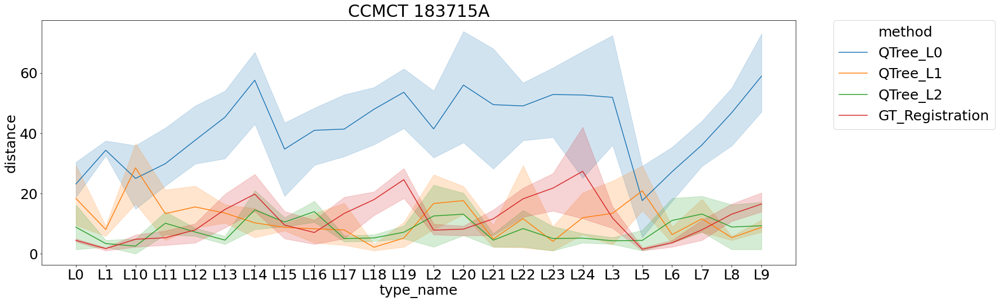

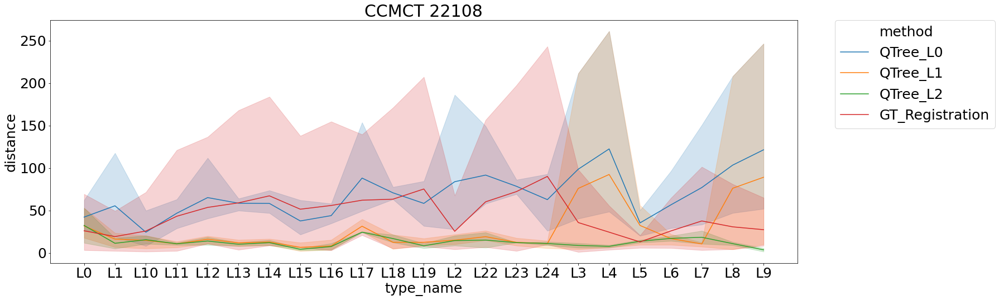

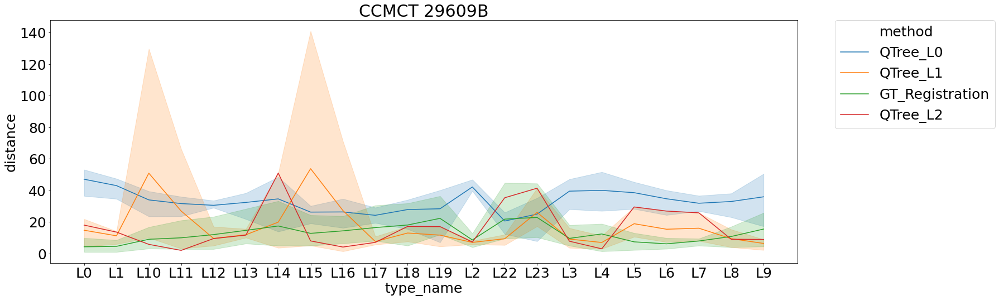

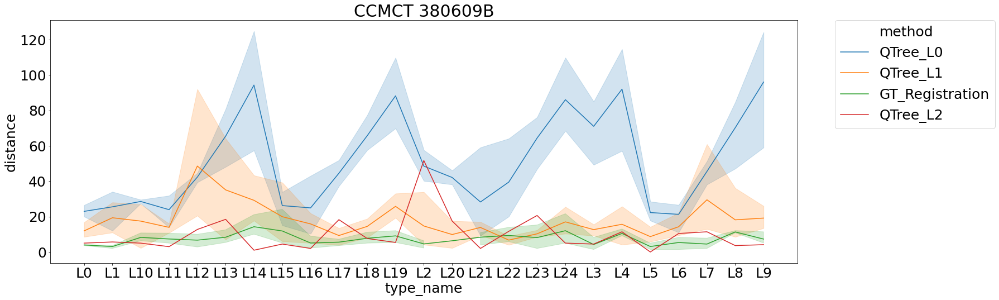

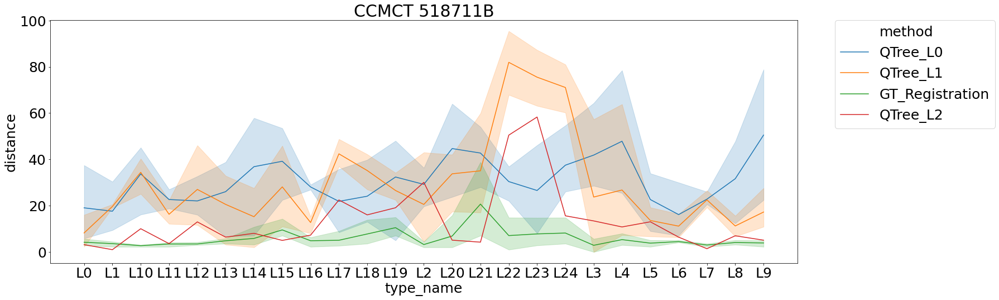

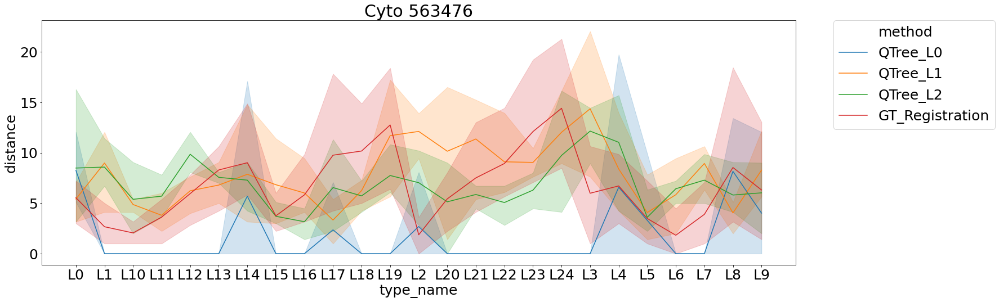

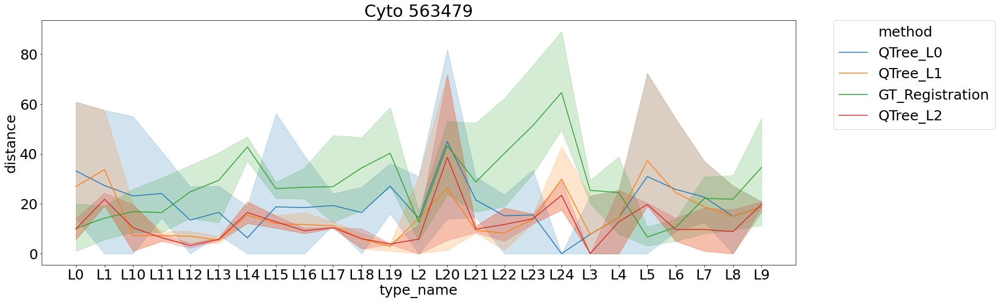

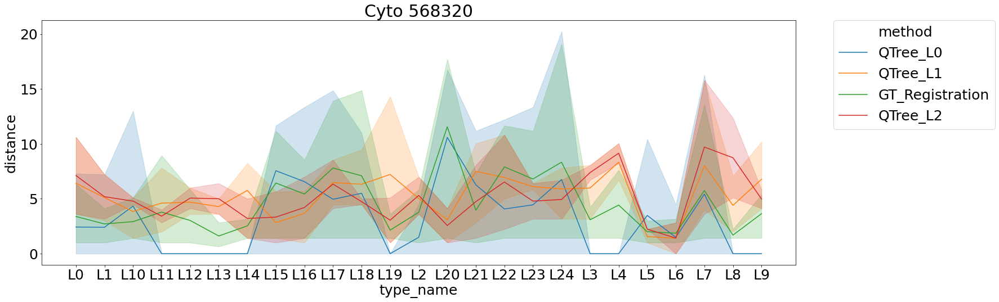

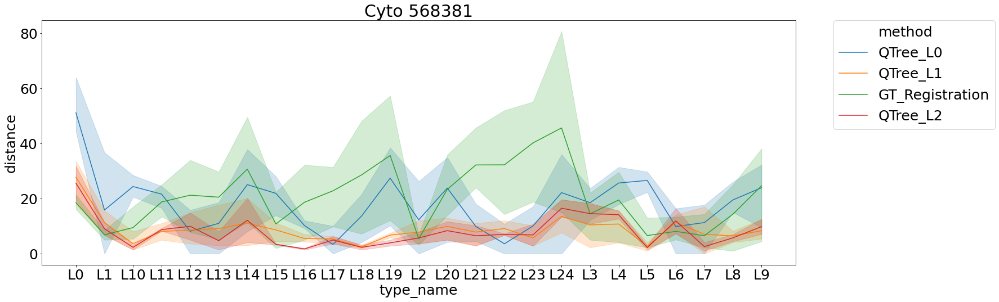

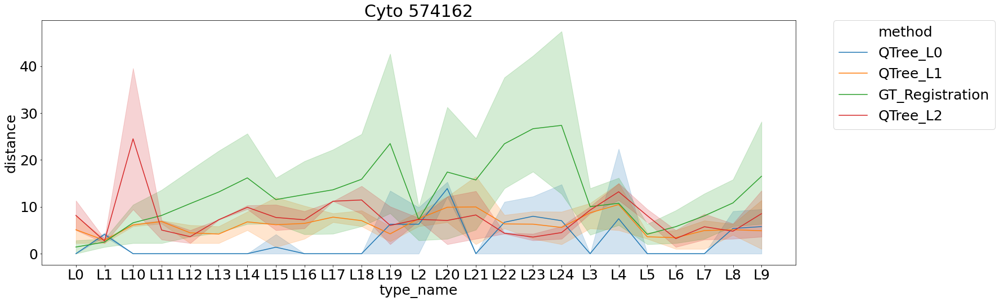

In [32]:
for patient_id in results["patient_id"].unique():
    
    patient_data = results[results["patient_id"] == patient_id]
    
    fig, ax = plt.subplots(figsize=(24, 8))
    
    ax.set_title(f"{patient_data.iloc[0].image_type} {patient_id}")
    sns.lineplot(x="type_name", y="distance",
             hue="method",  #scanner
             #style="method",
             data=patient_data, ax=ax)
    
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.show()
    

d:\anaconda3\envs\eiph_wsi\lib\site-packages\seaborn\matrix.py:305: UserWarning: Attempting to set identical left == right == 0 results in singular transformations; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))
d:\anaconda3\envs\eiph_wsi\lib\site-packages\seaborn\matrix.py:305: UserWarning: Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))


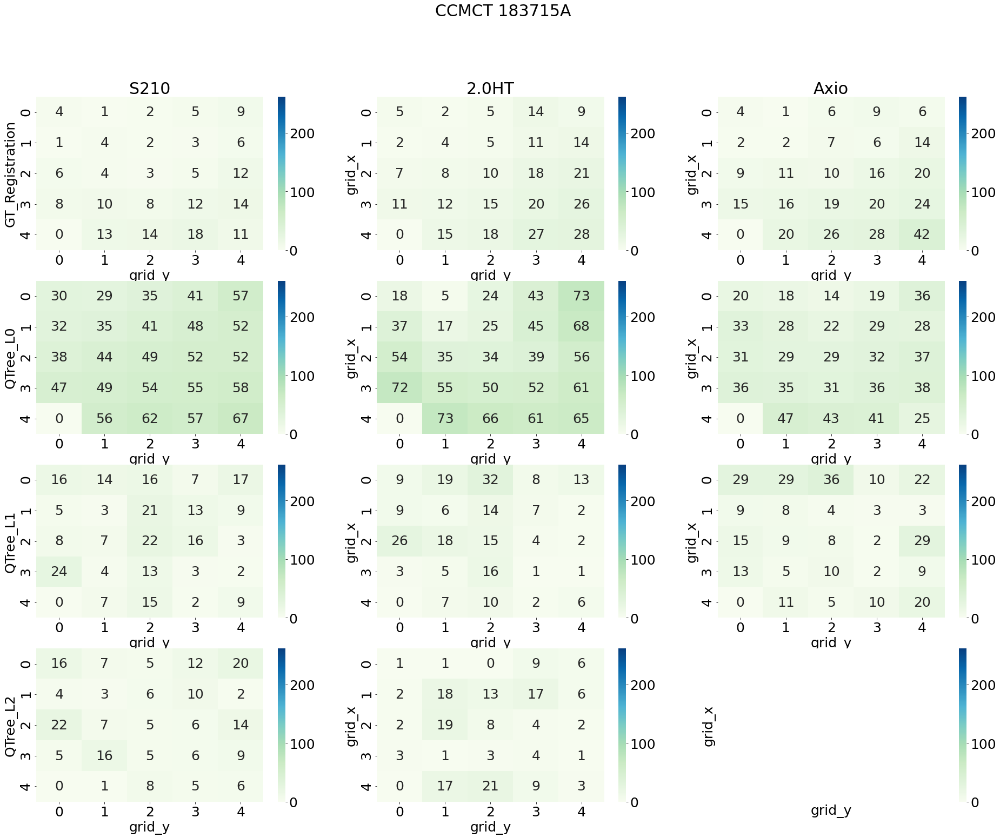

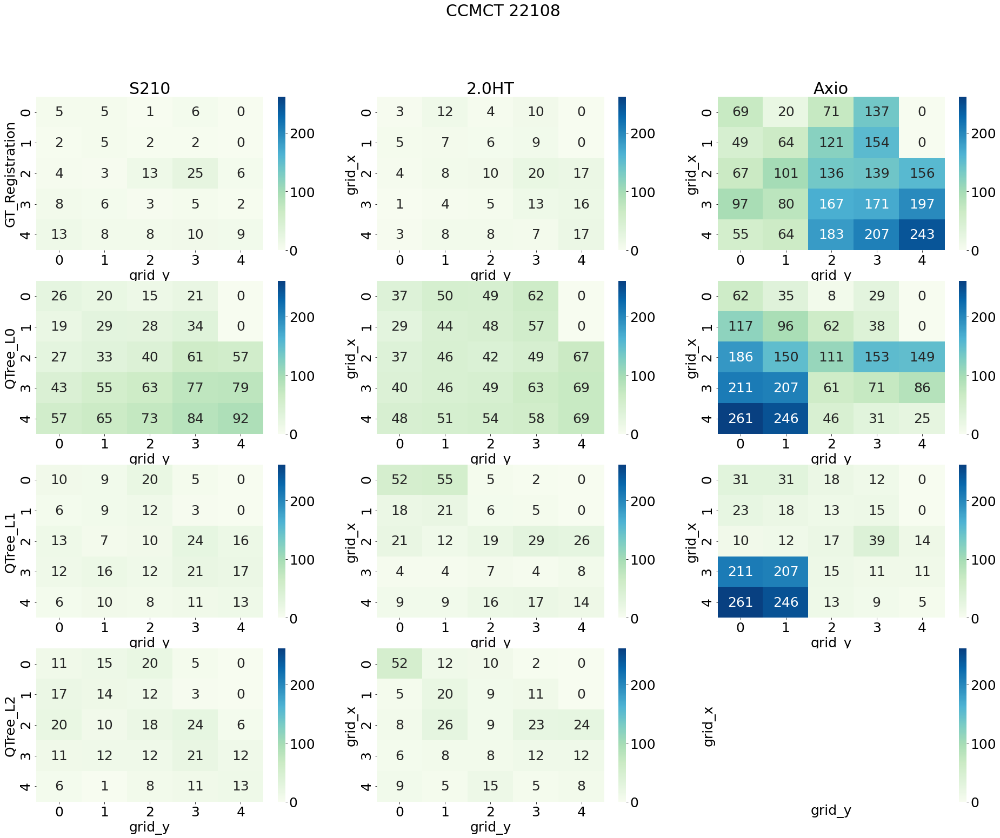

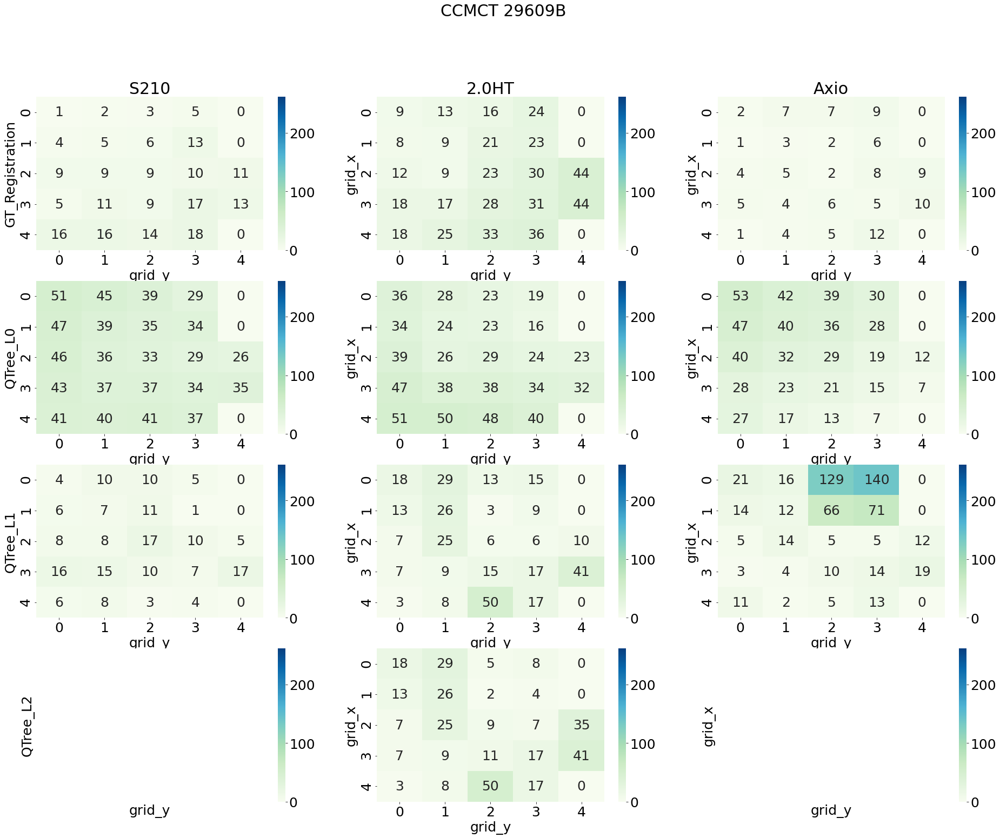

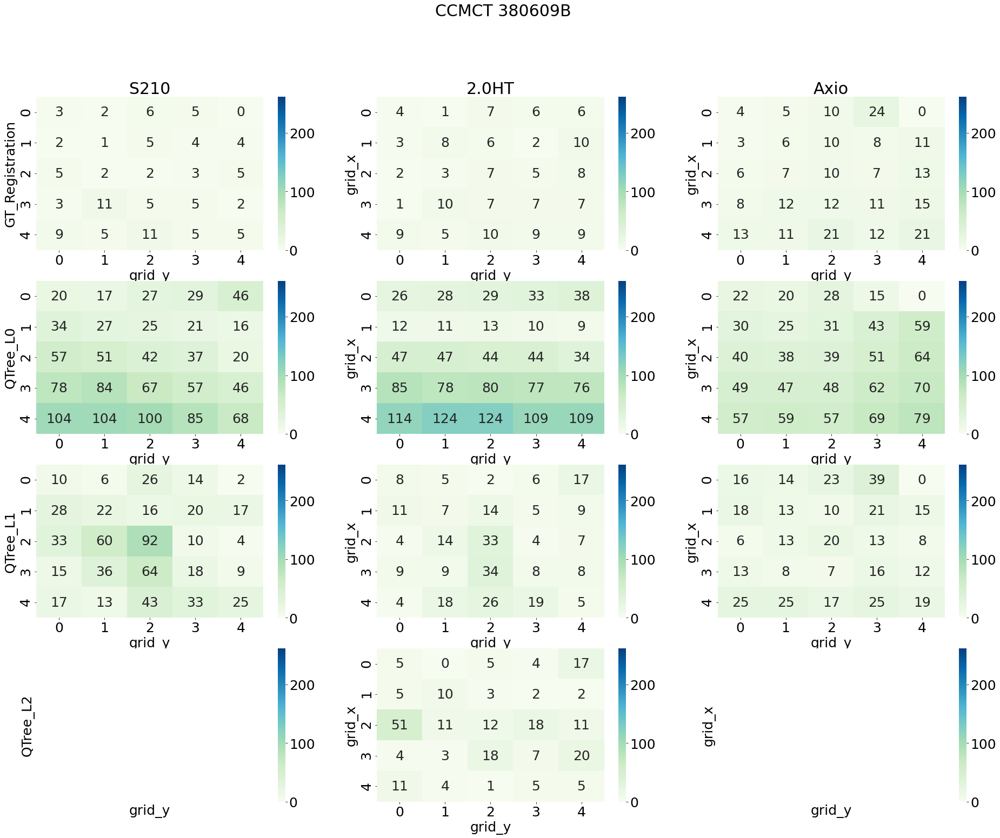

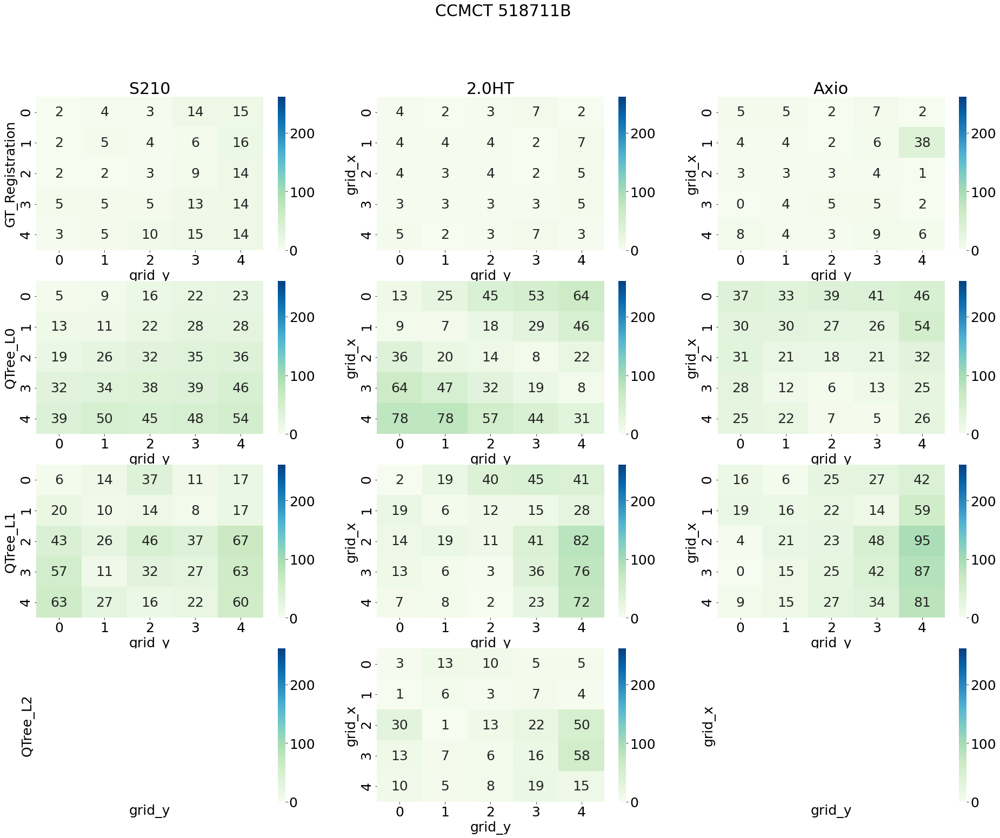

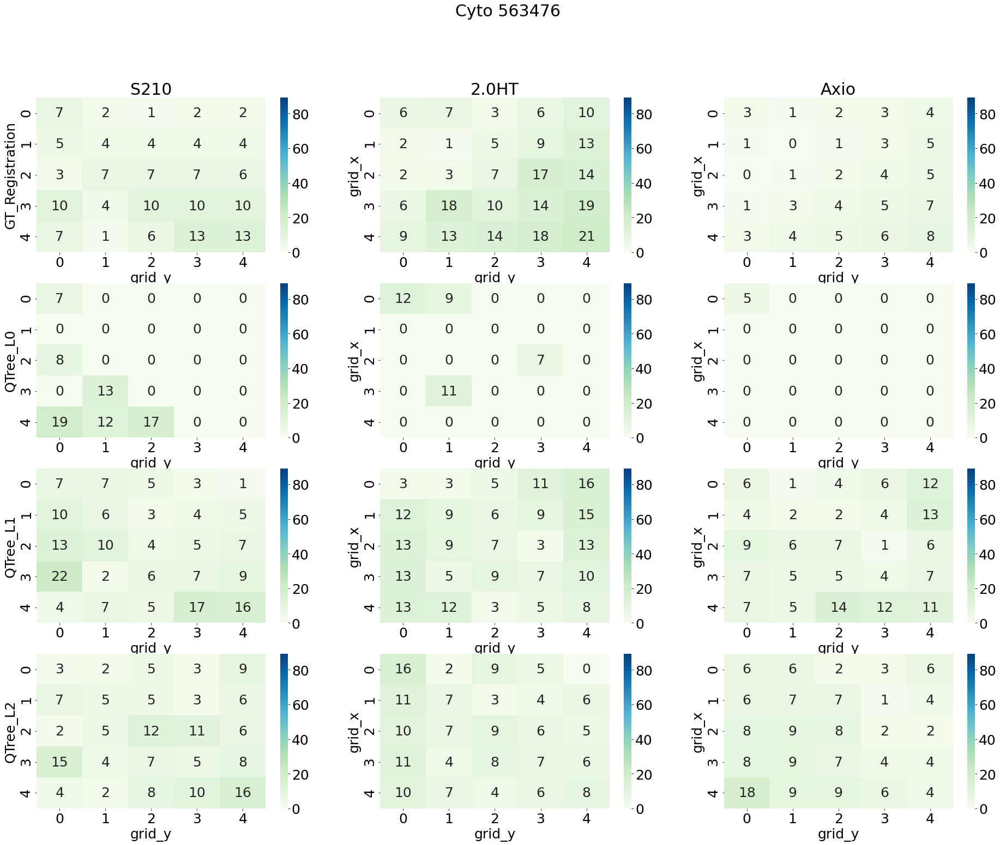

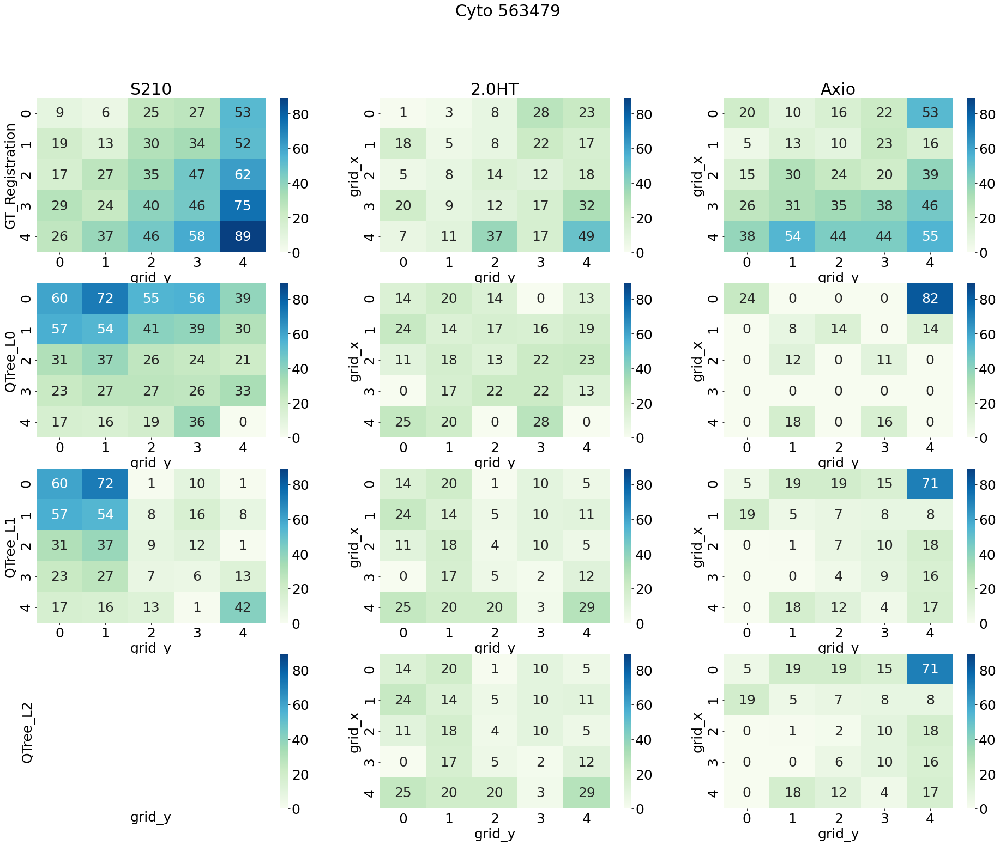

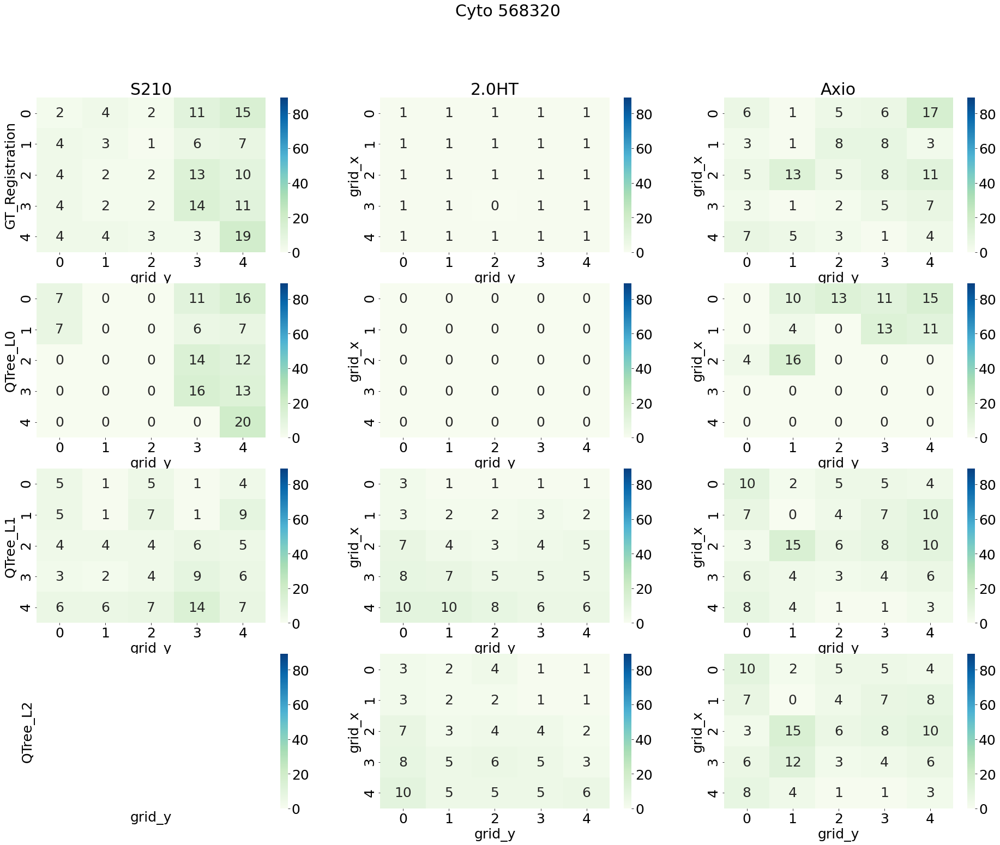

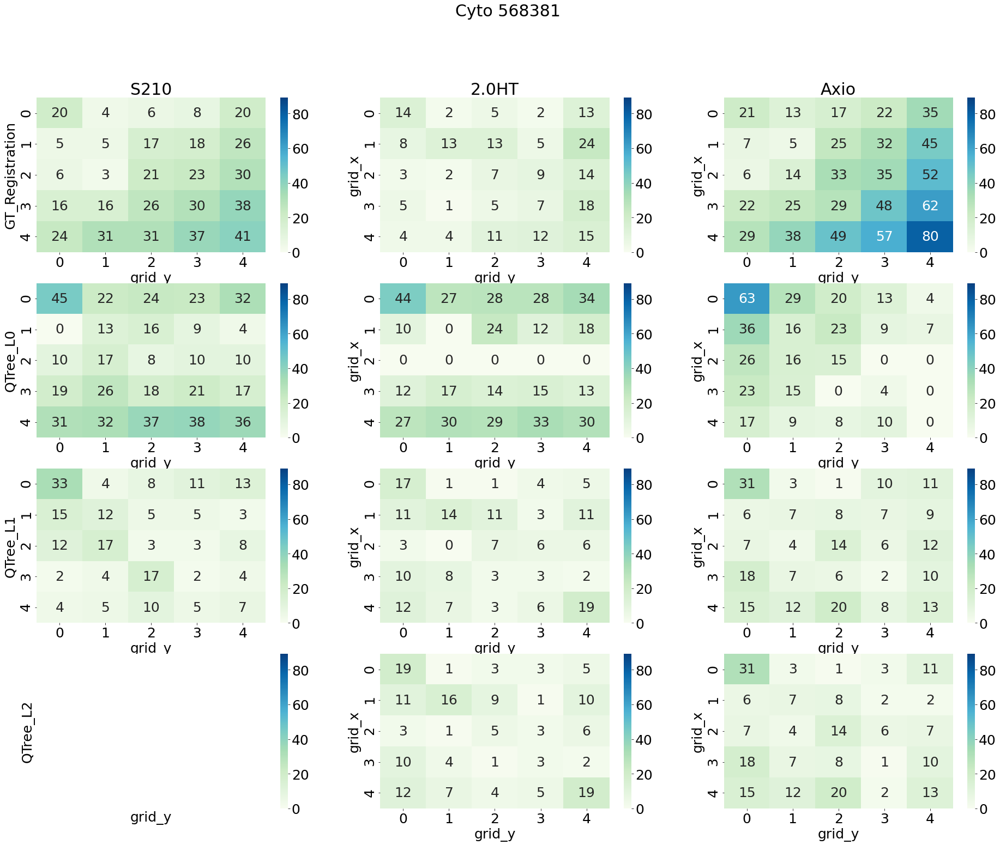

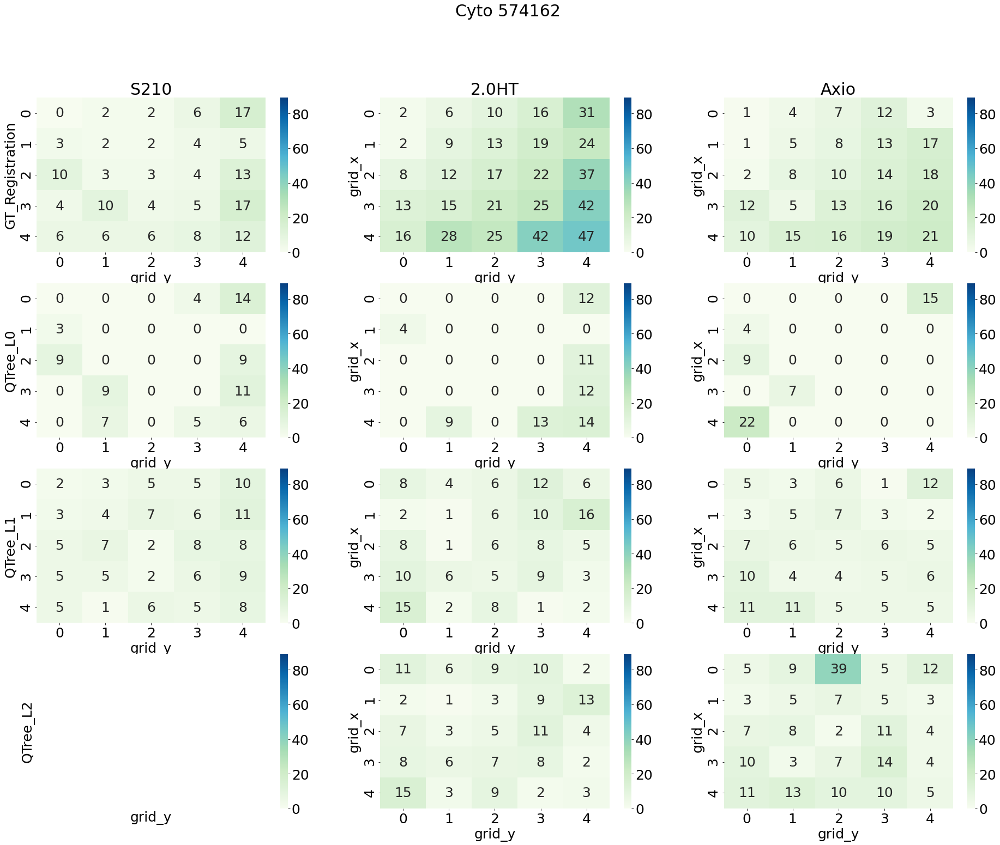

In [33]:
for patient_id in results["patient_id"].unique():
    
    patient_data = results[results["patient_id"] == patient_id]
    
    max_distance = max(results[results["image_type"] == patient_data.iloc[0].image_type]["distance"])
    
    fig, ((ax_1, ax_2, ax_3), (ax_4, ax_5, ax_6), 
          (ax_7, ax_8, ax_9), (ax_10, ax_11, ax_12))  = plt.subplots(4, 3, figsize=(32, 24))
    
    fig.suptitle(f"{patient_data.iloc[0].image_type} {patient_id}")
    
    for scanner, ax, method in [
                        ("S210", ax_1, "GT_Registration"), ("2.0HT", ax_2, "GT_Registration"), ("Axio", ax_3, "GT_Registration"),
                        ("S210", ax_4, "QTree_L0"), ("2.0HT", ax_5, "QTree_L0"), ("Axio", ax_6, "QTree_L0"),
                        ("S210", ax_7, "QTree_L1"), ("2.0HT", ax_8, "QTree_L1"), ("Axio", ax_9, "QTree_L1"),
                        ("S210", ax_10, "QTree_L2"), ("2.0HT", ax_11, "QTree_L2"), ("Axio", ax_12, "QTree_L2"),
                       ]:
        
        
        data = patient_data[(patient_data["scanner"] == scanner) & (patient_data["method"] == method)]
        
        if method == "GT_Registration":
            ax.set_title(f"{data.iloc[0].scanner}")
        
        sns.heatmap(data.pivot("grid_x", "grid_y", "distance").replace(np.nan, 0).astype(int), 
                ax=ax, annot=True, cmap="GnBu", fmt="d", vmin=0, vmax=max_distance)

        if scanner == "S210":
            ax.set_ylabel(method)
        
    plt.show()
    

## Quiver Plot

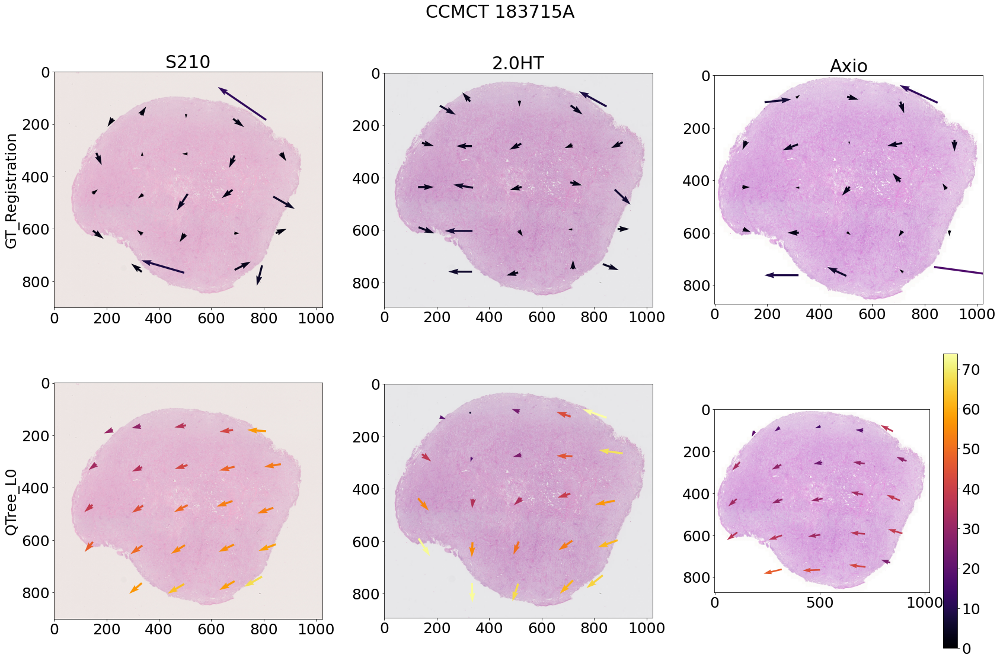

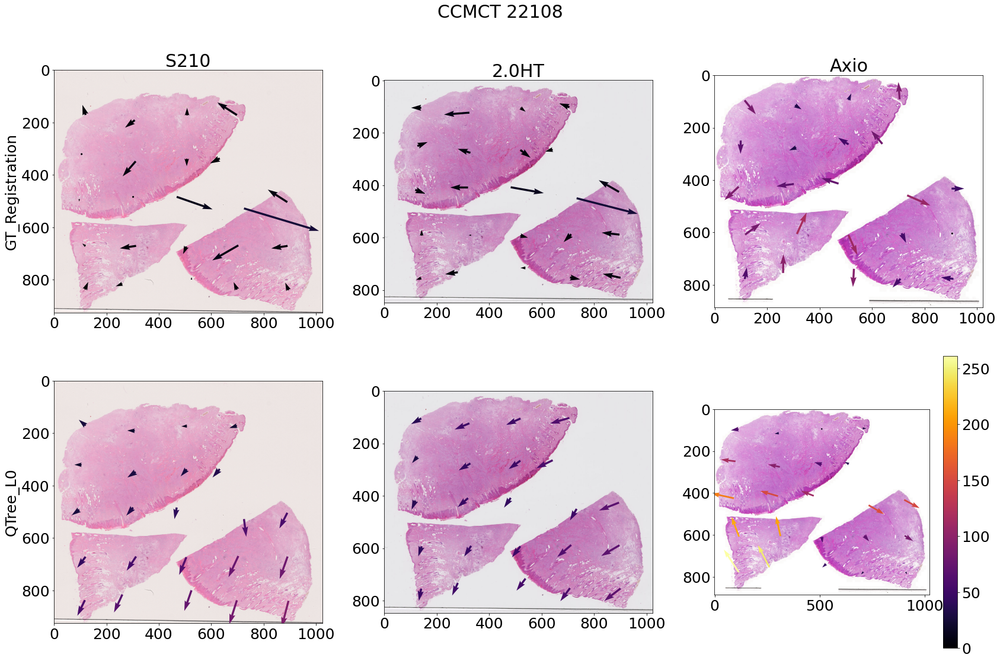

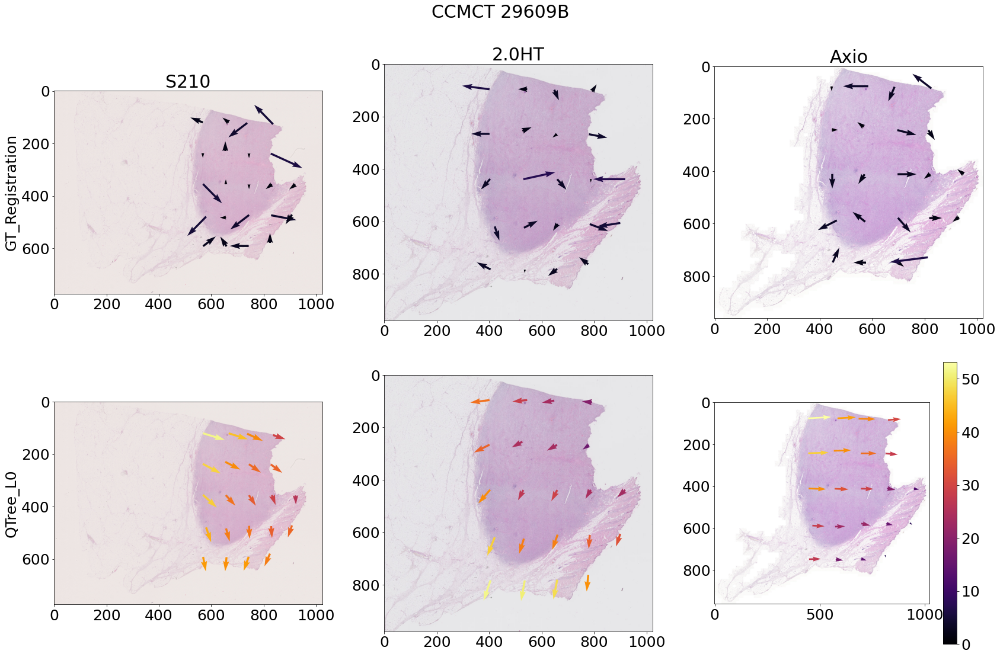

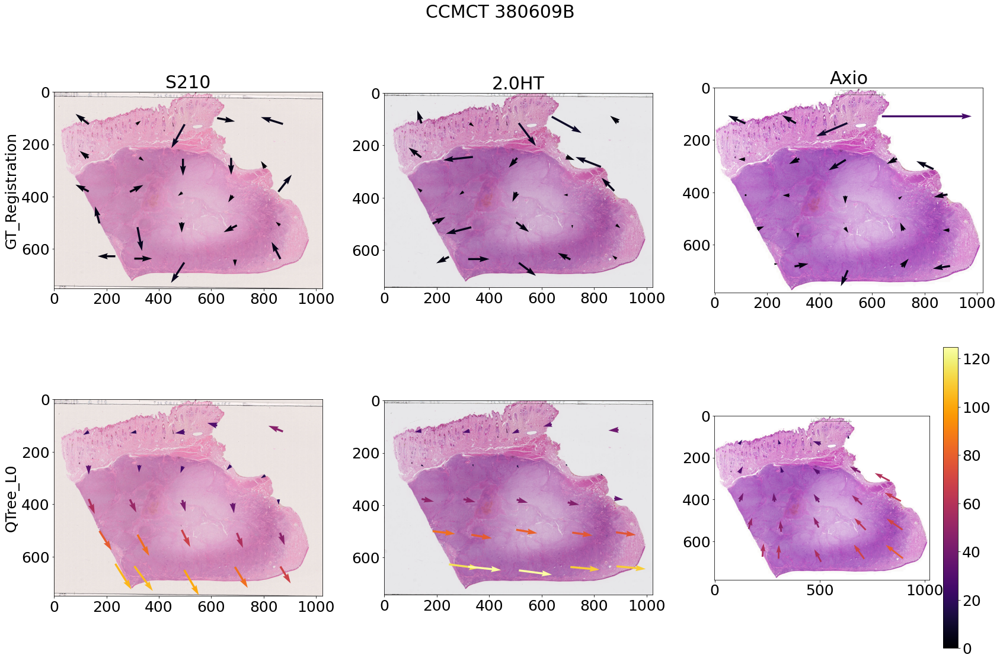

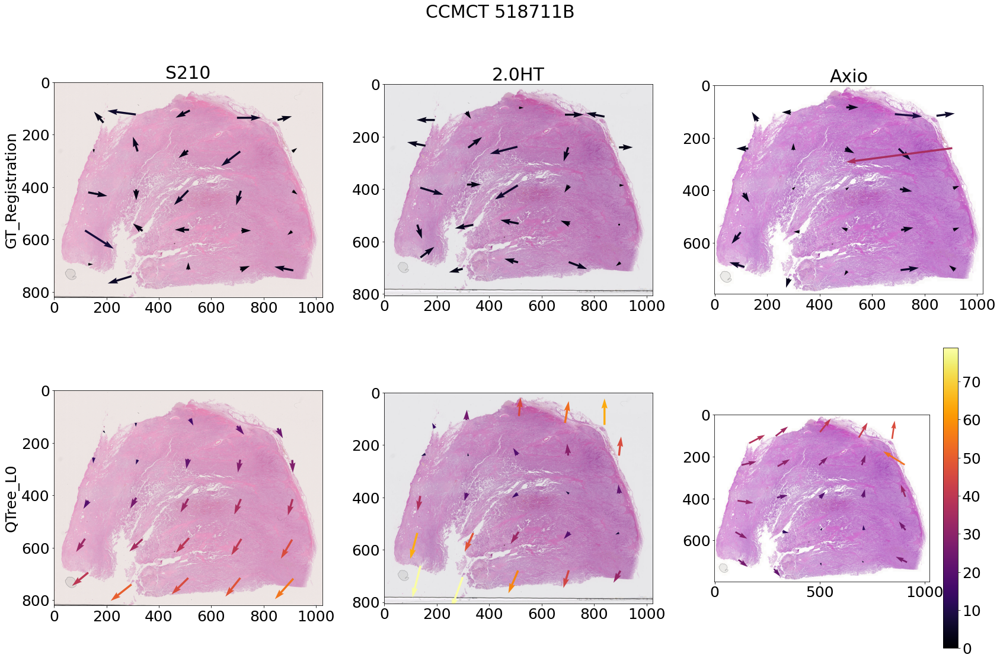

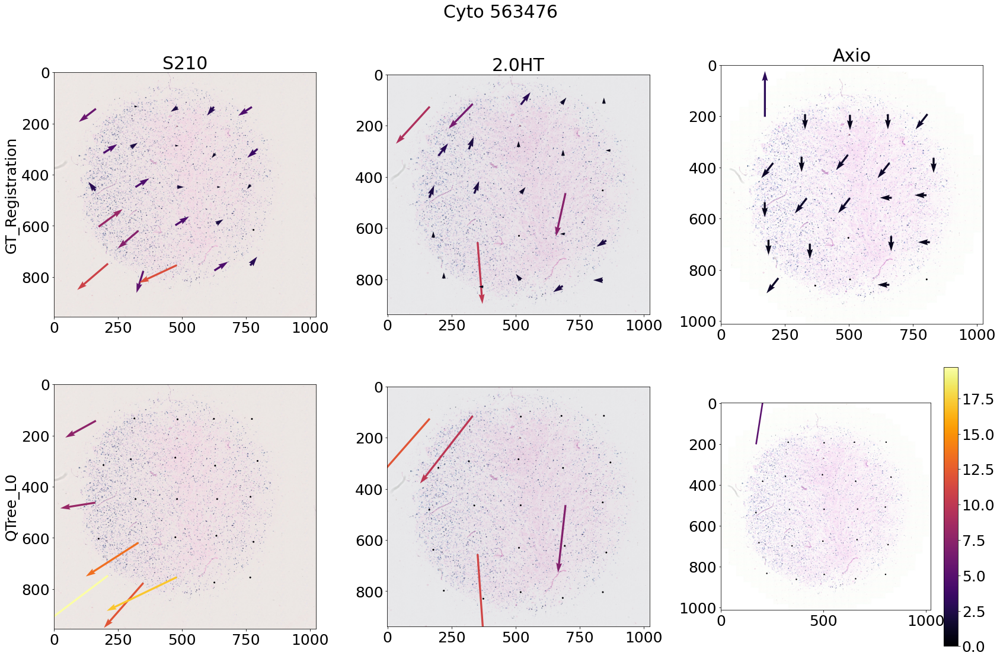

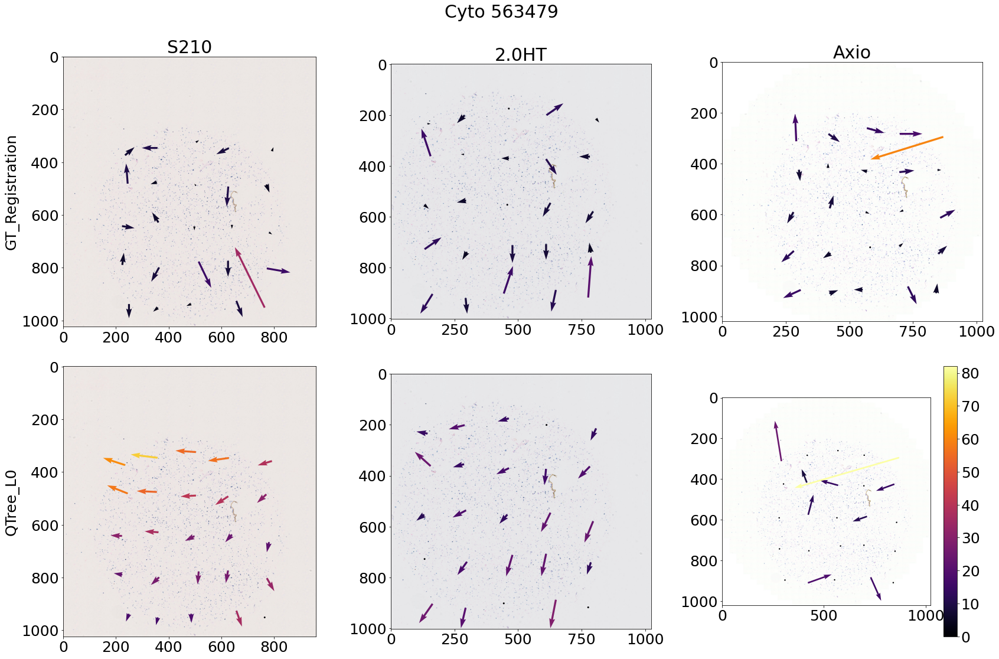

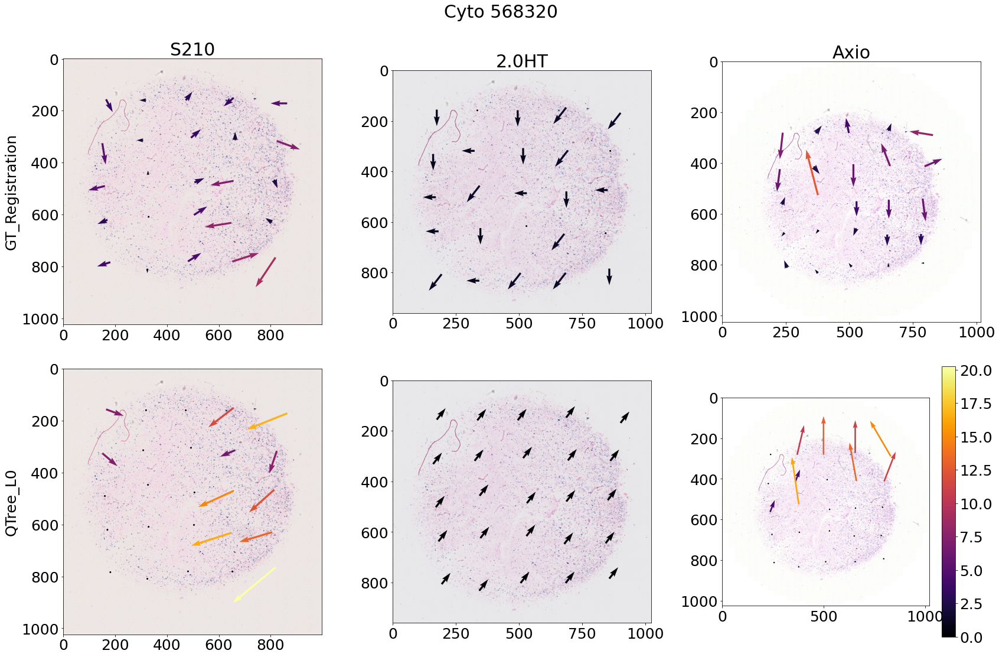

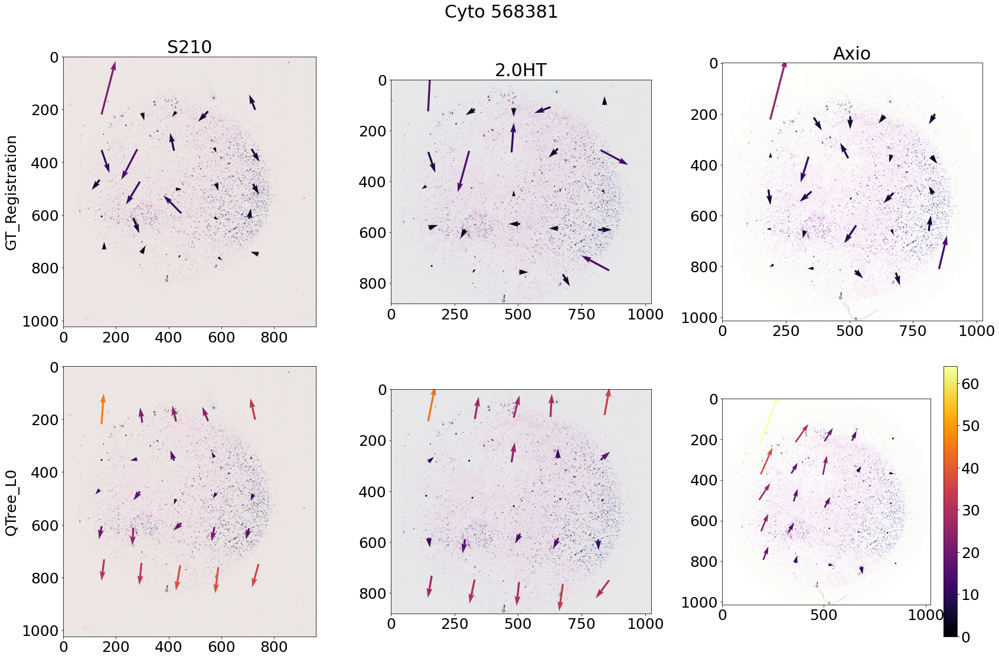

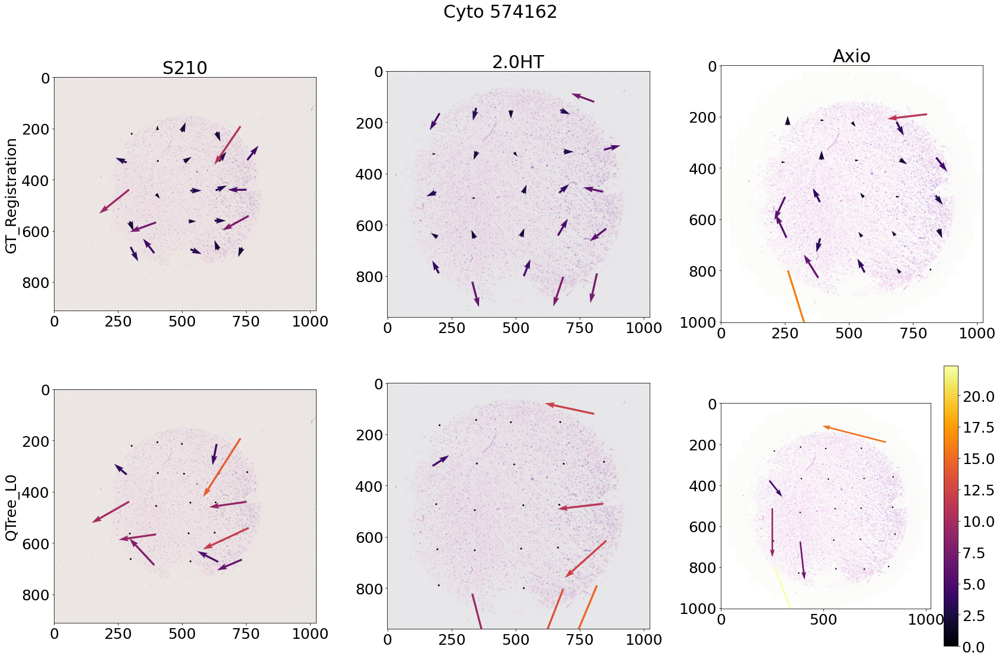

In [70]:
import matplotlib
import matplotlib.cm as cm
colormap = cm.inferno
    

for patient_id in results["patient_id"].unique():
    
    patient_data = results[results["patient_id"] == patient_id]
    image_type_data = results[results["image_type"] == patient_data.iloc[0].image_type]
    u_max = max(abs(image_type_data["x_end"] - image_type_data["x_start"] + 0.0001))
    v_max = max(abs(image_type_data["y_end"] - image_type_data["y_start"] + 0.0001))
    
    #max_distance = max(results[results["patient_id"] == patient_data.iloc[0].patient_id]["distance"])
    max_distance = max(patient_data["distance"])
    
    fig, ((ax_1, ax_2, ax_3), (ax_4, ax_5, ax_6)) = plt.subplots(2, 3, figsize=(24, 16))
    
    fig.suptitle(f"{patient_data.iloc[0].image_type} {patient_id}")
    
    for scanner, ax, method in [
                        ("S210", ax_1, "GT_Registration"), ("2.0HT", ax_2, "GT_Registration"), ("Axio", ax_3, "GT_Registration"),
                        ("S210", ax_4, "QTree_L0"), ("2.0HT", ax_5, "QTree_L0"), ("Axio", ax_6, "QTree_L0"),
                       ]:
        
        data = patient_data[(patient_data["scanner"] == scanner) & (patient_data["method"] == method)]
        distance = colormap(data["distance"] / max_distance)
        
        x, y = data["x_start"], data["y_start"]
        u, v = (data["x_end"] - data["x_start"] + 0.0001) / u_max, (data["y_end"] - data["y_start"] + 0.0001) / v_max
        
        if method == "GT_Registration":
            ax.set_title(f"{scanner}")
        
        ax.imshow(slide_list[data.iloc[0].image_name])
        ax.quiver(x, y, u, v, color=distance)
        
        if scanner == "S210":
            ax.set_ylabel(method)

    #fig.colorbar(sm, ax=ax_3, orientation='vertical')
    norm = matplotlib.colors.Normalize()
    norm.autoscale([0, max_distance])

    sm = matplotlib.cm.ScalarMappable(cmap=colormap, norm=norm) #, norm=norm
    sm.set_array([])
    
    plt.colorbar(sm)    
    plt.tight_layout()
    plt.show()
    